In [33]:
import os
from pathlib import Path
import argparse
from termios import VINTR
import numpy as np
import pandas as pd
import json
import pickle
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import yaml
from pathlib import Path

from rica.domain.vibration import vibration

In [34]:
home_folder_to_get_and_save=Path("/home/shankar/GRA/R@/rica/projects/lathrop/day_1_62.5/predict_all_database/predict_oct_13")

In [35]:
raw_power=pd.read_csv(home_folder_to_get_and_save/"raw_power.csv")
std_power=pd.read_csv(home_folder_to_get_and_save/"standardized_power.csv")

In [36]:
raw_power.head()

,Unnamed: 0,time,total_power,p0,p1,p2,p3,p4,p5,p6,density,heading,latitude,longitude,passID,speed,temperature
0,0,2022-09-29 13:48:53.222000+00:00,100.000000,0.000023,1.215282e-03,1.094663e-03,6.280556e-04,4.504007e-04,0.000389,0.000314,94.97,180.0,0.000000,0.000000,0.0,0.000,101.131714
1,1,2022-09-29 13:48:53.350000+00:00,100.000000,0.000654,3.517038e-05,2.833226e-06,1.009788e-06,5.573103e-06,0.000008,0.000004,90.24,180.0,0.000000,0.000000,0.0,0.000,100.159724
2,2,2022-09-29 13:48:53.478000+00:00,100.000000,0.000397,1.326325e-06,4.309250e-07,8.241666e-07,7.313684e-07,0.000001,0.000004,90.03,0.0,37.819975,-121.276682,0.0,0.035,100.475626
3,3,2022-09-29 13:48:53.606000+00:00,66.401727,0.000005,7.536362e-07,2.266725e-06,1.911071e-06,1.821548e-06,0.000004,0.000005,90.03,0.0,37.819975,-121.276682,0.0,0.035,100.524224
4,4,2022-09-29 13:48:53.734000+00:00,39.037399,0.000028,2.611317e-07,3.090757e-06,1.574115e-06,1.348815e-06,0.000003,0.000002,90.03,0.0,37.819975,-121.276682,0.0,0.035,101.569115


In [37]:
std_power.head()

,Unnamed: 0,time,total_power,p0,p1,p2,p3,p4,p5,p6,density,heading,latitude,longitude,passID,speed,temperature,centroid_no
0,0,2022-09-29 13:48:53.222000+00:00,100.000000,-3.935043,0.479368,1.940873,3.397457,2.116158,0.902051,0.475878,94.26,180.0,0.000000,0.000000,0.0,0.000,101.131714,4
1,1,2022-09-29 13:48:53.350000+00:00,100.000000,-3.865978,-0.979223,-1.314680,-0.983086,-0.884123,-0.684477,-0.942579,89.53,180.0,0.000000,0.000000,0.0,0.000,100.159724,0
2,2,2022-09-29 13:48:53.478000+00:00,100.000000,-3.894153,-1.021053,-1.321843,-0.984383,-0.916780,-0.712582,-0.941095,89.53,0.0,37.819975,-121.276682,0.0,0.035,100.475626,0
3,3,2022-09-29 13:48:53.606000+00:00,66.401727,-3.937013,-1.021761,-1.316369,-0.976789,-0.909427,-0.701496,-0.937413,89.53,0.0,37.819975,-121.276682,0.0,0.035,100.524224,0
4,4,2022-09-29 13:48:53.734000+00:00,39.037399,-3.934493,-1.022370,-1.313912,-0.979143,-0.912615,-0.704276,-0.950405,89.53,0.0,37.819975,-121.276682,0.0,0.035,101.569115,0


In [38]:
cores_data=pd.read_csv(home_folder_to_get_and_save/"times_over_cores.tsv", sep='\t')
cores_data.head()

,name,passID,start_time,stop_time
0,"Lathrop, R4, NDG 94.3",30.0,2022-09-29 18:41:33.985000+00:00,2022-09-29 18:41:35.777000+00:00
1,"Lathrop, R4, NDG 94.3",31.0,2022-09-29 18:42:55.009000+00:00,2022-09-29 18:42:56.801000+00:00
2,"Lathrop, R4, NDG 94.3",32.0,2022-09-29 18:45:06.977000+00:00,2022-09-29 18:45:08.769000+00:00
3,"Lathrop, R4, NDG 94.3",47.0,2022-09-29 18:57:42.945000+00:00,2022-09-29 18:57:44.865000+00:00
4,"Lathrop, R4, NDG 94.3",48.0,2022-09-29 19:01:43.969000+00:00,2022-09-29 19:01:44.865000+00:00


In [39]:
list_name_of_cores=cores_data["name"].unique()
list_name_of_cores

array(['Lathrop, R4, NDG 94.3', 'Lathrop, R5, NDG 94.5',
       'Lathrop, R6, NDG 94', 'Lathrop, R3, NDG 95',
       'Lathrop, R2, NDG 95', 'Lathrop, R1, NDG 95'], dtype=object)

In [70]:
def create_one_folder(folder_loc):
    if not os.path.exists(folder_loc):
        os.makedirs(folder_loc)
        print(f"Created folder at {folder_loc}")

def create_folders(list_of_folder_names,path_to_create):
    newpaths = [path_to_create/str(folder_name_1) for folder_name_1 in list_of_folder_names]
    [create_one_folder(path1) for path1 in newpaths]

    
create_folders(list_name_of_cores,
               home_folder_to_get_and_save/"image_data_in_cores")

In [71]:
cores_data.head()

,name,passID,start_time,stop_time
0,"Lathrop, R4, NDG 94.3",30.0,2022-09-29 18:41:33.985000+00:00,2022-09-29 18:41:35.777000+00:00
1,"Lathrop, R4, NDG 94.3",31.0,2022-09-29 18:42:55.009000+00:00,2022-09-29 18:42:56.801000+00:00
2,"Lathrop, R4, NDG 94.3",32.0,2022-09-29 18:45:06.977000+00:00,2022-09-29 18:45:08.769000+00:00
3,"Lathrop, R4, NDG 94.3",47.0,2022-09-29 18:57:42.945000+00:00,2022-09-29 18:57:44.865000+00:00
4,"Lathrop, R4, NDG 94.3",48.0,2022-09-29 19:01:43.969000+00:00,2022-09-29 19:01:44.865000+00:00


In [85]:
# cores_data.values

In [72]:
def create_plots(data_df, centers_t, to_save_location, image_name, norm=True):
    no_of_subplots = centers_t
    fig, axes = plt.subplots(no_of_subplots + 1, 1, figsize=(15, 49))
    colors = [
        "green",
        "red",
        "black",
        "yellow",
        "purple",
        "cyan",
        "magenta",
        "brown",
        "pink",
    ]
    # labels = ["C0", "C1", "C2", "C3", "C4", "C5", "C6", "C7", "C8"]
    fig.tight_layout()
    for position in range(centers_t):
        data_df.plot(x="time", y="p" + str(position), ax=axes[position])
    data_df.plot(x="time", y="density", ax=axes[no_of_subplots])
    red_patch = mpatches.Patch(color="red", label="The red data")
    handles = []
    # for i in range(centers_t):
    #     handle = mpatches.Patch(color=colors[i], label=labels[i])
    #     handles.append(handle)
    fig.legend(handles=handles, loc="upper right")
    fig.savefig(to_save_location / image_name)

In [73]:
cores_data.values[0]

array(['Lathrop, R4, NDG 94.3', 30.0, '2022-09-29 18:41:33.985000+00:00',
       '2022-09-29 18:41:35.777000+00:00'], dtype=object)

# Print_its

        Unnamed: 0                              time  total_power        p0  \
100857      100857  2022-09-29 18:41:33.985000+00:00        100.0  0.046068   
100858      100858  2022-09-29 18:41:34.113000+00:00        100.0  0.045679   
100859      100859  2022-09-29 18:41:34.241000+00:00        100.0  0.045024   
100860      100860  2022-09-29 18:41:34.369000+00:00        100.0  0.045257   
100861      100861  2022-09-29 18:41:34.497000+00:00        100.0  0.047385   

              p1        p2        p3        p4        p5        p6  density  \
100857  0.002224  0.000143  0.000107  0.000169  0.000018  0.000169    94.97   
100858  0.001567  0.000244  0.000156  0.000111  0.000157  0.000381    94.97   
100859  0.002803  0.001102  0.000275  0.000017  0.000160  0.000216    94.97   
100860  0.001898  0.000437  0.000590  0.000057  0.000159  0.000210    94.97   
100861  0.002210  0.000393  0.000126  0.000040  0.000419  0.000245    94.76   

        heading   latitude  longitude  passID  spe

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


        Unnamed: 0                              time  total_power        p0  \
111042      111042  2022-09-29 19:03:17.921000+00:00    62.128720  0.032835   
111043      111043  2022-09-29 19:03:18.049000+00:00    56.614301  0.035109   
111044      111044  2022-09-29 19:03:18.177000+00:00    62.289173  0.034199   
111045      111045  2022-09-29 19:03:18.305000+00:00    74.760393  0.031510   
111046      111046  2022-09-29 19:03:18.433000+00:00    50.470565  0.031038   

              p1        p2        p3        p4        p5        p6  density  \
111042  0.000649  0.000208  0.000055  0.000068  0.000029  0.000333    93.66   
111043  0.000686  0.000063  0.000015  0.000036  0.000192  0.000117    93.66   
111044  0.001531  0.000544  0.000191  0.000143  0.000069  0.000063    94.97   
111045  0.001312  0.001046  0.000262  0.000150  0.000042  0.000271    94.97   
111046  0.000862  0.000307  0.000101  0.000031  0.000101  0.000066    94.76   

        heading   latitude   longitude  passID  sp

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


        Unnamed: 0                              time  total_power        p0  \
116901      116901  2022-09-29 19:15:47.873000+00:00    82.011383  0.038937   
116902      116902  2022-09-29 19:15:48.001000+00:00    82.366870  0.038283   
116903      116903  2022-09-29 19:15:48.129000+00:00    64.021088  0.038554   
116904      116904  2022-09-29 19:15:48.257000+00:00    95.395501  0.037935   
116905      116905  2022-09-29 19:15:48.385000+00:00    74.540794  0.037242   

              p1        p2        p3        p4        p5        p6  density  \
116901  0.002345  0.000254  0.000101  0.000051  0.000094  0.000382    94.76   
116902  0.001992  0.000494  0.000386  0.000104  0.000265  0.000141    94.97   
116903  0.001643  0.000193  0.000085  0.000119  0.000168  0.000036    94.97   
116904  0.002156  0.000522  0.000137  0.000280  0.000349  0.000304    94.97   
116905  0.003051  0.000695  0.000114  0.000091  0.000118  0.000095    94.97   

        heading   latitude   longitude  passID  sp

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


        Unnamed: 0                              time  total_power        p0  \
117612      117612  2022-09-29 19:17:18.881000+00:00    51.133236  0.023130   
117613      117613  2022-09-29 19:17:19.009000+00:00    52.902943  0.020188   
117614      117614  2022-09-29 19:17:19.137000+00:00    39.731481  0.023729   
117615      117615  2022-09-29 19:17:19.265000+00:00    47.993621  0.025392   
117616      117616  2022-09-29 19:17:19.393000+00:00    54.144690  0.027382   

              p1        p2        p3        p4        p5        p6  density  \
117612  0.001429  0.000046  0.000026  0.000263  0.000037  0.000195    94.76   
117613  0.000650  0.000064  0.000349  0.000067  0.000068  0.000320    94.76   
117614  0.000808  0.000252  0.000100  0.000024  0.000118  0.000019    94.76   
117615  0.001093  0.000327  0.000044  0.000018  0.000052  0.000174    94.76   
117616  0.001498  0.000387  0.000063  0.000251  0.000047  0.000083    94.76   

        heading   latitude   longitude  passID  sp

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


        Unnamed: 0                              time  total_power        p0  \
170571      170571  2022-09-29 21:10:17.889000+00:00     0.304632  0.000007   
170572      170572  2022-09-29 21:10:18.017000+00:00     0.372589  0.000007   
170573      170573  2022-09-29 21:10:18.145000+00:00     0.454837  0.000007   
170574      170574  2022-09-29 21:10:18.273000+00:00     0.108360  0.000001   
170575      170575  2022-09-29 21:10:18.401000+00:00     0.113873  0.000001   

                  p1            p2            p3            p4            p5  \
170571  1.820703e-06  2.801739e-06  1.370091e-06  9.665434e-07  1.180819e-06   
170572  8.951930e-07  1.799449e-06  3.623440e-07  5.751934e-06  1.720123e-06   
170573  6.560164e-06  7.175370e-07  6.280130e-07  1.173890e-06  2.357885e-06   
170574  5.164229e-07  7.936132e-07  2.483851e-07  8.131921e-07  2.072857e-07   
170575  4.467501e-06  1.251701e-06  4.199975e-07  5.788259e-07  5.864255e-07   

                  p6  density  heading   lat

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


        Unnamed: 0                              time  total_power        p0  \
107362      107362  2022-09-29 18:55:26.881000+00:00    90.869983  0.040261   
107363      107363  2022-09-29 18:55:27.009000+00:00    72.388569  0.036551   
107364      107364  2022-09-29 18:55:27.137000+00:00    56.801442  0.035652   
107365      107365  2022-09-29 18:55:27.265000+00:00    53.672449  0.035767   
107366      107366  2022-09-29 18:55:27.393000+00:00    66.644218  0.034895   

              p1        p2        p3        p4        p5        p6  density  \
107362  0.000789  0.000319  0.000159  0.000043  0.000695  0.000180    94.76   
107363  0.001522  0.000145  0.000195  0.000070  0.000068  0.000316    94.97   
107364  0.001506  0.000114  0.000017  0.000147  0.000048  0.000081    94.76   
107365  0.001217  0.000292  0.000085  0.000054  0.000020  0.000056    94.76   
107366  0.000742  0.000162  0.000027  0.000238  0.000030  0.000298    93.66   

        heading   latitude   longitude  passID  sp

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


        Unnamed: 0                              time  total_power        p0  \
107605      107605  2022-09-29 18:55:57.985000+00:00    77.203517  0.044321   
107606      107606  2022-09-29 18:55:58.113000+00:00    67.306757  0.045326   
107607      107607  2022-09-29 18:55:58.241000+00:00    85.055546  0.050099   
107608      107608  2022-09-29 18:55:58.369000+00:00    91.888323  0.049796   
107609      107609  2022-09-29 18:55:58.497000+00:00    76.191210  0.045655   

              p1        p2        p3        p4        p5        p6  density  \
107605  0.002172  0.000266  0.000137  0.000192  0.000201  0.000031    94.97   
107606  0.001420  0.000109  0.000059  0.000012  0.000102  0.000104    94.76   
107607  0.001214  0.000483  0.000034  0.000043  0.000151  0.000246    94.76   
107608  0.001135  0.000503  0.000128  0.000489  0.000129  0.000141    94.97   
107609  0.001293  0.000533  0.000331  0.000245  0.000038  0.000036    94.97   

        heading   latitude   longitude  passID  sp

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


        Unnamed: 0                              time  total_power        p0  \
111370      111370  2022-09-29 19:03:59.905000+00:00    55.071674  0.029486   
111371      111371  2022-09-29 19:04:00.033000+00:00    51.296944  0.031394   
111372      111372  2022-09-29 19:04:00.161000+00:00    75.815681  0.033439   
111373      111373  2022-09-29 19:04:00.289000+00:00    95.137494  0.033324   
111374      111374  2022-09-29 19:04:00.417000+00:00    58.450857  0.033452   

              p1        p2        p3        p4        p5        p6  density  \
111370  0.000153  0.000353  0.000094  0.000087  0.000275  0.000080    93.66   
111371  0.000429  0.000469  0.000056  0.000068  0.000091  0.000083    93.66   
111372  0.000025  0.000491  0.000102  0.000055  0.000072  0.000537    93.66   
111373  0.000440  0.000427  0.000075  0.000109  0.000382  0.000634    93.66   
111374  0.000356  0.000195  0.000207  0.000099  0.000271  0.000034    94.76   

        heading   latitude  longitude  passID  spe

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


        Unnamed: 0                              time  total_power        p0  \
116581      116581  2022-09-29 19:15:06.913000+00:00    58.679650  0.034021   
116582      116582  2022-09-29 19:15:07.041000+00:00    71.978824  0.033170   
116583      116583  2022-09-29 19:15:07.169000+00:00    58.656149  0.034313   
116584      116584  2022-09-29 19:15:07.297000+00:00    95.572454  0.034283   
116585      116585  2022-09-29 19:15:07.425000+00:00    82.439709  0.032615   

              p1        p2        p3        p4        p5        p6  density  \
116581  0.002089  0.000021  0.000125  0.000052  0.000045  0.000134    94.76   
116582  0.002264  0.000106  0.000152  0.000082  0.000458  0.000044    94.97   
116583  0.001200  0.000332  0.000165  0.000100  0.000014  0.000129    94.97   
116584  0.002500  0.000524  0.000108  0.000280  0.000109  0.000540    94.97   
116585  0.002608  0.000194  0.000196  0.000307  0.000034  0.000391    94.97   

        heading   latitude  longitude  passID  spe

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


        Unnamed: 0                              time  total_power        p0  \
117933      117933  2022-09-29 19:17:59.969000+00:00    64.756753  0.025958   
117934      117934  2022-09-29 19:18:00.097000+00:00    44.571141  0.024288   
117935      117935  2022-09-29 19:18:00.225000+00:00    47.845856  0.026736   
117936      117936  2022-09-29 19:18:00.353000+00:00    54.435754  0.027998   
117937      117937  2022-09-29 19:18:00.481000+00:00    41.687325  0.027193   

              p1        p2        p3        p4        p5        p6  density  \
117933  0.000047  0.000664  0.000027  0.000034  0.000016  0.000525    93.66   
117934  0.000333  0.000344  0.000119  0.000052  0.000120  0.000099    93.66   
117935  0.000261  0.000569  0.000053  0.000062  0.000014  0.000169    93.66   
117936  0.000265  0.000509  0.000170  0.000085  0.000143  0.000134    94.76   
117937  0.000155  0.000265  0.000041  0.000079  0.000015  0.000103    93.66   

        heading   latitude   longitude  passID  sp

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


       Unnamed: 0                              time  total_power        p0  \
16613       16613  2022-09-29 15:34:37.643000+00:00    70.883569  0.022509   
16614       16614  2022-09-29 15:34:37.771000+00:00    56.685548  0.018018   
16615       16615  2022-09-29 15:34:37.899000+00:00    44.526120  0.016322   
16616       16616  2022-09-29 15:34:38.027000+00:00    41.077126  0.017799   
16617       16617  2022-09-29 15:34:38.155000+00:00    47.438392  0.018965   

             p1        p2        p3        p4        p5        p6  density  \
16613  0.000227  0.000037  0.000415  0.000065  0.000212  0.000274    91.34   
16614  0.000616  0.000049  0.000036  0.000143  0.000355  0.000094    91.34   
16615  0.000684  0.000123  0.000014  0.000107  0.000142  0.000105    91.34   
16616  0.000542  0.000054  0.000199  0.000116  0.000062  0.000041    91.34   
16617  0.002105  0.000054  0.000086  0.000075  0.000082  0.000030    93.66   

       heading   latitude   longitude  passID  speed  temperat

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


       Unnamed: 0                              time  total_power        p0  \
18686       18686  2022-09-29 15:39:05.731000+00:00    70.036865  0.037275   
18687       18687  2022-09-29 15:39:05.859000+00:00    92.814716  0.038685   
18688       18688  2022-09-29 15:39:05.987000+00:00    87.907550  0.040177   
18689       18689  2022-09-29 15:39:06.115000+00:00   100.000000  0.039304   
18690       18690  2022-09-29 15:39:06.243000+00:00   100.000000  0.041156   

             p1        p2        p3        p4        p5        p6  density  \
18686  0.000911  0.000194  0.000140  0.000119  0.000014  0.000083    93.66   
18687  0.001405  0.000086  0.000054  0.000012  0.000182  0.000340    93.66   
18688  0.003306  0.000044  0.000145  0.000041  0.000172  0.000051    93.66   
18689  0.003334  0.000209  0.000281  0.000574  0.000157  0.000071    94.97   
18690  0.001215  0.000134  0.000038  0.000172  0.000087  0.000578    93.66   

       heading   latitude   longitude  passID  speed  temperat

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


       Unnamed: 0                              time  total_power        p0  \
22811       22811  2022-09-29 15:47:53.731000+00:00    77.927388  0.039146   
22812       22812  2022-09-29 15:47:53.859000+00:00    84.306871  0.033657   
22813       22813  2022-09-29 15:47:53.987000+00:00   100.000000  0.042143   
22814       22814  2022-09-29 15:47:54.115000+00:00   100.000000  0.051319   
22815       22815  2022-09-29 15:47:54.243000+00:00   100.000000  0.050530   

             p1        p2        p3        p4        p5        p6  density  \
22811  0.001634  0.000279  0.000015  0.000053  0.000069  0.000125    94.76   
22812  0.004069  0.000589  0.000047  0.000058  0.000108  0.000037    94.97   
22813  0.004034  0.000423  0.000336  0.000138  0.000093  0.000193    94.97   
22814  0.005686  0.000457  0.000385  0.000086  0.000351  0.000145    94.97   
22815  0.004017  0.000113  0.000040  0.000013  0.000056  0.000313    94.76   

       heading   latitude   longitude  passID  speed  temperat

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


       Unnamed: 0                              time  total_power        p0  \
23678       23678  2022-09-29 15:49:44.707000+00:00    89.231892  0.043193   
23679       23679  2022-09-29 15:49:44.835000+00:00    84.817254  0.042776   
23680       23680  2022-09-29 15:49:44.963000+00:00    93.078829  0.039259   
23681       23681  2022-09-29 15:49:45.091000+00:00    70.316374  0.035969   
23682       23682  2022-09-29 15:49:45.219000+00:00   100.000000  0.034632   

             p1        p2        p3        p4        p5        p6  density  \
23678  0.000430  0.000562  0.000128  0.000081  0.000226  0.000095    93.66   
23679  0.000087  0.000540  0.000136  0.000039  0.000169  0.000129    93.66   
23680  0.000497  0.001559  0.000063  0.000142  0.000083  0.000140    94.76   
23681  0.000041  0.000487  0.000018  0.000061  0.000073  0.000157    93.66   
23682  0.000489  0.000396  0.000071  0.000074  0.000152  0.000748    93.66   

       heading  latitude   longitude  passID  speed  temperatu

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


       Unnamed: 0                              time  total_power        p0  \
24029       24029  2022-09-29 15:50:29.635000+00:00    87.385532  0.031847   
24030       24030  2022-09-29 15:50:29.763000+00:00    59.864732  0.034202   
24031       24031  2022-09-29 15:50:29.891000+00:00    54.182224  0.031366   
24032       24032  2022-09-29 15:50:30.019000+00:00    58.979875  0.023919   
24033       24033  2022-09-29 15:50:30.147000+00:00    40.956911  0.019145   

             p1        p2        p3        p4        p5        p6  density  \
24029  0.000624  0.000239  0.000096  0.000042  0.000094  0.000469    93.66   
24030  0.000581  0.000028  0.000057  0.000159  0.000027  0.000045    91.34   
24031  0.000491  0.000011  0.000056  0.000028  0.000086  0.000050    91.34   
24032  0.000582  0.000052  0.000229  0.000009  0.000115  0.000192    91.34   
24033  0.000283  0.000094  0.000067  0.000076  0.000070  0.000082    91.34   

       heading   latitude   longitude  passID  speed  temperat

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


       Unnamed: 0                              time  total_power        p0  \
17801       17801  2022-09-29 15:37:09.707000+00:00    96.716451  0.044299   
17802       17802  2022-09-29 15:37:09.835000+00:00    83.978444  0.045590   
17803       17803  2022-09-29 15:37:09.963000+00:00   100.000000  0.044798   
17804       17804  2022-09-29 15:37:10.091000+00:00    92.314415  0.047509   
17805       17805  2022-09-29 15:37:10.219000+00:00    78.569296  0.045445   

             p1        p2        p3        p4        p5        p6  density  \
17801  0.001265  0.000288  0.000353  0.000113  0.000220  0.000084    94.76   
17802  0.001304  0.000578  0.000248  0.000027  0.000005  0.000042    94.97   
17803  0.001903  0.000396  0.000104  0.000200  0.000189  0.000114    94.97   
17804  0.002365  0.000363  0.000070  0.000056  0.000011  0.000121    94.97   
17805  0.001308  0.000297  0.000096  0.000033  0.000021  0.000048    94.76   

       heading   latitude   longitude  passID  speed  temperat

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


       Unnamed: 0                              time  total_power        p0  \
19037       19037  2022-09-29 15:39:50.659000+00:00    73.302750  0.038591   
19038       19038  2022-09-29 15:39:50.787000+00:00   100.000000  0.040989   
19039       19039  2022-09-29 15:39:50.915000+00:00    96.755365  0.038309   
19040       19040  2022-09-29 15:39:51.043000+00:00    96.147899  0.039730   
19041       19041  2022-09-29 15:39:51.171000+00:00    91.143049  0.041340   

             p1        p2        p3        p4        p5        p6  density  \
19037  0.000305  0.000204  0.000080  0.000022  0.000131  0.000137    91.34   
19038  0.002364  0.000429  0.000411  0.000193  0.000019  0.000199    94.97   
19039  0.003601  0.000097  0.000176  0.000060  0.000109  0.000217    93.66   
19040  0.000746  0.000231  0.000023  0.000091  0.000076  0.000446    93.66   
19041  0.000820  0.000123  0.000140  0.000225  0.000194  0.000157    93.66   

       heading   latitude   longitude  passID  speed  temperat

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


       Unnamed: 0                              time  total_power  \
75036       75036  2022-09-29 17:43:24.745000+00:00     0.389276   
75037       75037  2022-09-29 17:43:24.873000+00:00     0.369939   
75038       75038  2022-09-29 17:43:25.001000+00:00     0.214698   
75039       75039  2022-09-29 17:43:25.129000+00:00     0.255106   
75040       75040  2022-09-29 17:43:25.257000+00:00     0.427891   

                 p0        p1        p2            p3            p4  \
75036  6.146352e-07  0.000007  0.000002  8.418252e-07  5.986174e-07   
75037  1.812699e-06  0.000006  0.000002  4.374258e-06  5.209968e-06   
75038  3.598707e-06  0.000004  0.000003  3.348388e-06  4.163435e-07   
75039  1.820658e-06  0.000002  0.000002  4.864185e-07  1.934667e-06   
75040  1.562332e-06  0.000008  0.000005  2.785142e-06  5.484884e-07   

                 p5            p6  density  heading  latitude   longitude  \
75036  5.233482e-06  1.437593e-06    90.03  -86.609  37.81904 -121.291153   
75037  1.3

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


       Unnamed: 0                              time  total_power        p0  \
77411       77411  2022-09-29 17:48:28.745000+00:00    77.515666  0.038442   
77412       77412  2022-09-29 17:48:28.873000+00:00    75.454364  0.041667   
77413       77413  2022-09-29 17:48:29.001000+00:00    73.295614  0.040153   
77414       77414  2022-09-29 17:48:29.129000+00:00    61.688346  0.039030   
77415       77415  2022-09-29 17:48:29.257000+00:00    93.519418  0.040257   

             p1        p2        p3        p4        p5        p6  density  \
77411  0.000016  0.000253  0.000054  0.000157  0.000141  0.000309    93.66   
77412  0.000599  0.000210  0.000046  0.000111  0.000205  0.000147    93.66   
77413  0.001930  0.000253  0.000074  0.000091  0.000128  0.000081    94.76   
77414  0.001095  0.000190  0.000060  0.000033  0.000048  0.000076    94.76   
77415  0.001844  0.000033  0.000126  0.000107  0.000238  0.000371    94.97   

       heading   latitude   longitude  passID  speed  temperat

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


       Unnamed: 0                              time  total_power  \
82520       82520  2022-09-29 17:59:22.825000+00:00     0.409788   
82521       82521  2022-09-29 17:59:22.953000+00:00     0.170873   
82522       82522  2022-09-29 17:59:23.081000+00:00     0.149821   
82523       82523  2022-09-29 17:59:23.209000+00:00     0.208241   
82524       82524  2022-09-29 17:59:23.337000+00:00     0.340505   

                 p0        p1            p2            p3            p4  \
82520  1.205535e-07  0.000017  1.675593e-06  1.548700e-06  9.389900e-07   
82521  4.068367e-06  0.000008  3.914938e-06  8.827174e-07  3.094668e-07   
82522  8.233432e-06  0.000001  1.194373e-06  8.784178e-07  4.330576e-07   
82523  5.899399e-06  0.000007  9.653542e-07  1.135372e-06  1.662853e-06   
82524  1.678770e-06  0.000002  7.051987e-07  3.456801e-07  2.603647e-07   

                 p5            p6  density  heading   latitude  longitude  \
82520  1.479361e-06  2.107843e-06    90.24  -93.602  37.819047 

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


        Unnamed: 0                              time  total_power        p0  \
171165      171165  2022-09-29 21:11:33.921000+00:00     0.176999  0.000003   
171166      171166  2022-09-29 21:11:34.049000+00:00     0.256336  0.000001   
171167      171167  2022-09-29 21:11:34.177000+00:00     0.337480  0.000004   
171168      171168  2022-09-29 21:11:34.305000+00:00     0.368944  0.000005   
171169      171169  2022-09-29 21:11:34.433000+00:00     0.313568  0.000005   

                  p1            p2            p3            p4        p5  \
171165  9.410976e-06  1.771079e-06  4.309542e-07  8.140916e-07  0.000001   
171166  1.079312e-06  8.541974e-07  1.518648e-06  2.407122e-06  0.000001   
171167  8.077635e-07  2.521188e-07  2.452072e-06  4.015708e-07  0.000003   
171168  4.603561e-07  1.560567e-06  2.488364e-07  1.323696e-06  0.000003   
171169  2.062660e-06  1.278198e-06  1.464974e-06  1.272874e-06  0.000004   

                  p6  density  heading   latitude   longitude  passI

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


       Unnamed: 0                              time  total_power        p0  \
16059       16059  2022-09-29 15:33:26.731000+00:00   100.000000  0.053284   
16060       16060  2022-09-29 15:33:26.859000+00:00   100.000000  0.051522   
16061       16061  2022-09-29 15:33:26.987000+00:00   100.000000  0.052522   
16062       16062  2022-09-29 15:33:27.115000+00:00   100.000000  0.051922   
16063       16063  2022-09-29 15:33:27.243000+00:00    88.390441  0.048367   

             p1        p2        p3        p4        p5        p6  density  \
16059  0.002270  0.000261  0.000005  0.000040  0.000020  0.000439    94.76   
16060  0.001617  0.000378  0.000019  0.000086  0.000218  0.000464    94.97   
16061  0.002257  0.000258  0.000033  0.000024  0.000058  0.000397    94.76   
16062  0.001235  0.000432  0.000048  0.000045  0.000026  0.001063    94.76   
16063  0.001956  0.000426  0.000013  0.000056  0.000045  0.000059    94.97   

       heading   latitude   longitude  passID  speed  temperat

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


       Unnamed: 0                              time  total_power  \
75224       75224  2022-09-29 17:43:48.809000+00:00     0.192227   
75225       75225  2022-09-29 17:43:48.937000+00:00     0.480882   
75226       75226  2022-09-29 17:43:49.065000+00:00     0.102615   
75227       75227  2022-09-29 17:43:49.193000+00:00     0.060656   
75228       75228  2022-09-29 17:43:49.321000+00:00     0.144609   

                 p0            p1            p2            p3            p4  \
75224  9.105282e-07  1.443454e-06  6.675247e-07  2.437222e-07  9.402052e-07   
75225  7.119503e-07  1.659914e-06  1.874715e-07  2.848050e-06  1.397481e-06   
75226  7.841964e-07  4.467153e-06  2.214829e-06  9.848460e-08  5.544946e-07   
75227  2.687318e-06  3.209631e-06  2.233900e-07  3.184798e-07  3.030755e-07   
75228  1.641189e-06  8.100593e-07  1.126169e-06  9.728882e-07  6.778330e-07   

                 p5            p6  density  heading   latitude   longitude  \
75224  1.403173e-06  1.482430e-06    9

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


       Unnamed: 0                              time  total_power        p0  \
82707       82707  2022-09-29 17:59:46.761000+00:00    55.865692  0.026719   
82708       82708  2022-09-29 17:59:46.889000+00:00    67.246247  0.025438   
82709       82709  2022-09-29 17:59:47.017000+00:00    78.644754  0.024083   
82710       82710  2022-09-29 17:59:47.145000+00:00    48.130710  0.020503   
82711       82711  2022-09-29 17:59:47.273000+00:00    38.542227  0.017426   

             p1        p2        p3        p4        p5        p6  density  \
82707  0.000048  0.000117  0.000062  0.000066  0.000184  0.000042    93.66   
82708  0.000289  0.000435  0.000120  0.000082  0.000061  0.000216    93.66   
82709  0.000055  0.000030  0.000414  0.000223  0.000044  0.000346    94.76   
82710  0.000729  0.000116  0.000043  0.000122  0.000055  0.000075    93.66   
82711  0.000154  0.000153  0.000065  0.000125  0.000014  0.000061    93.66   

       heading   latitude   longitude  passID  speed  temperat

/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


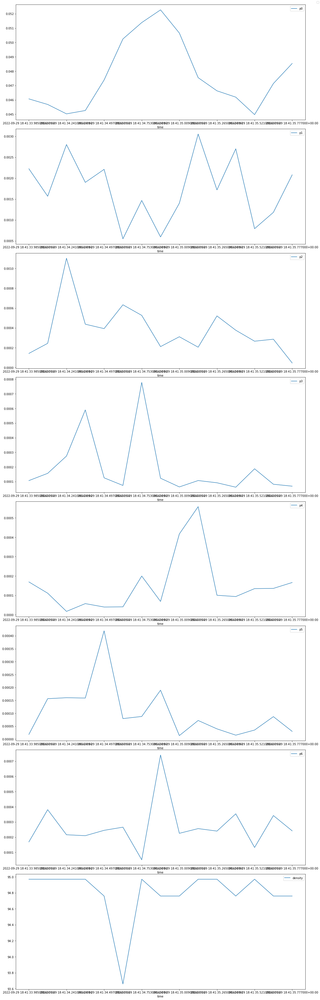

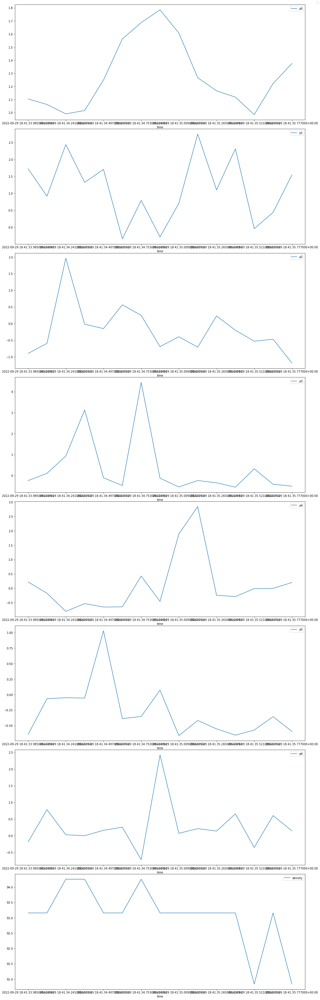

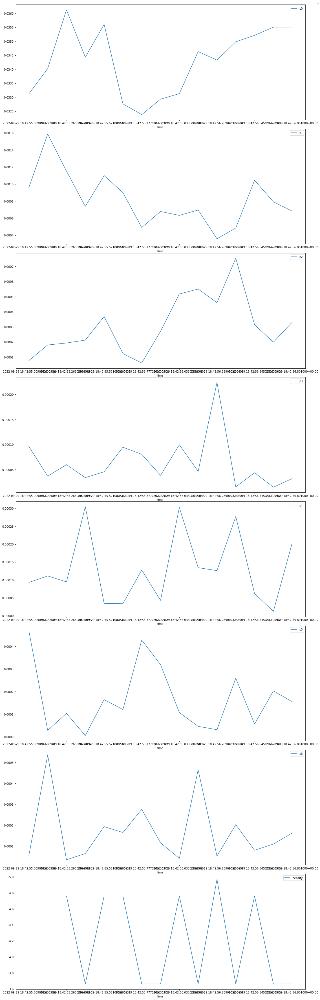

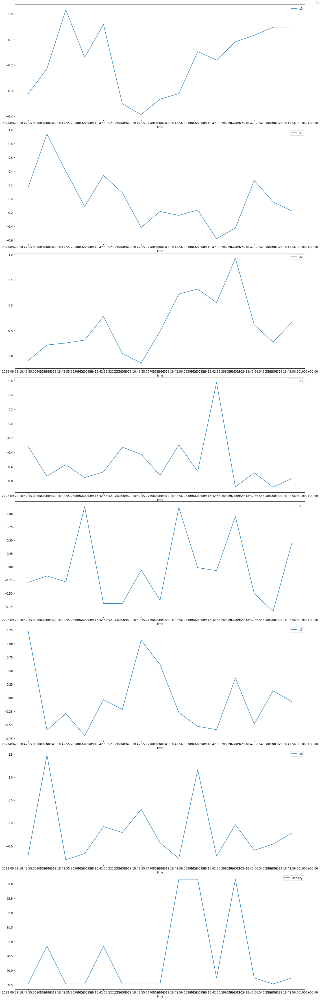

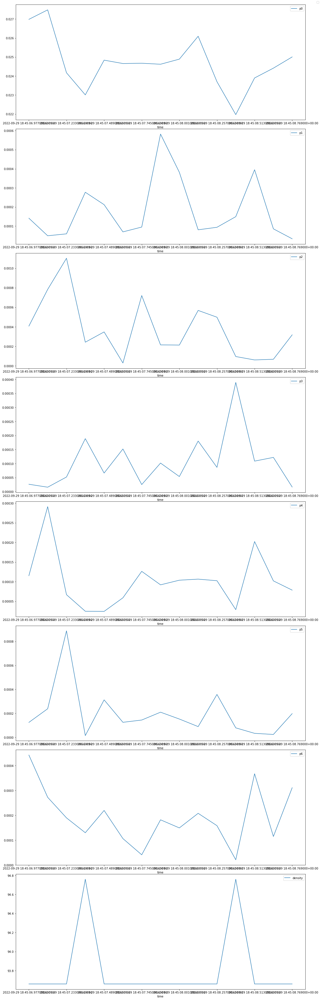

...

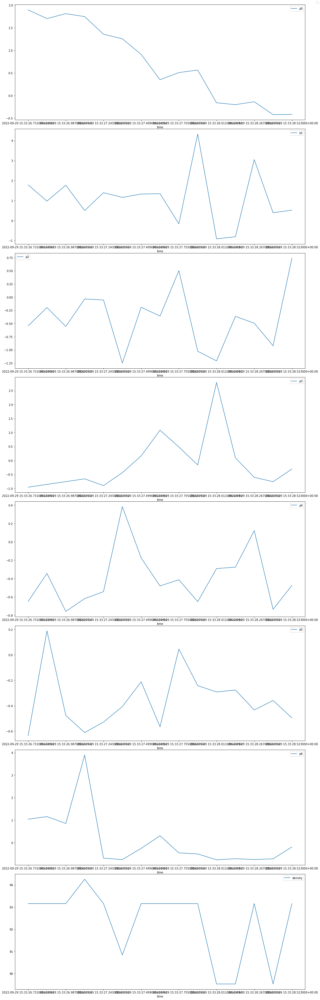

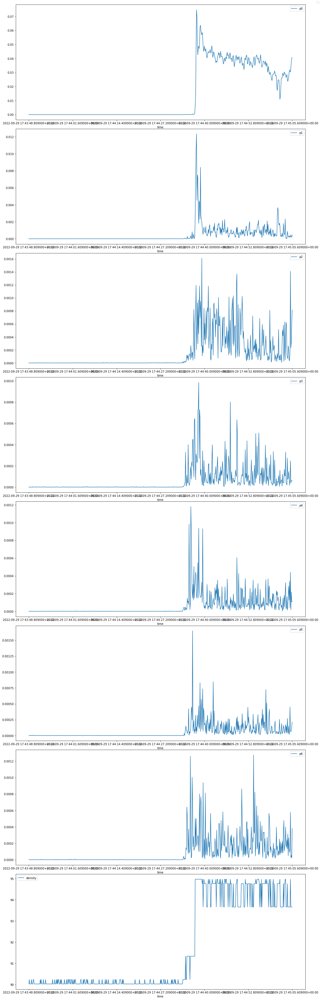

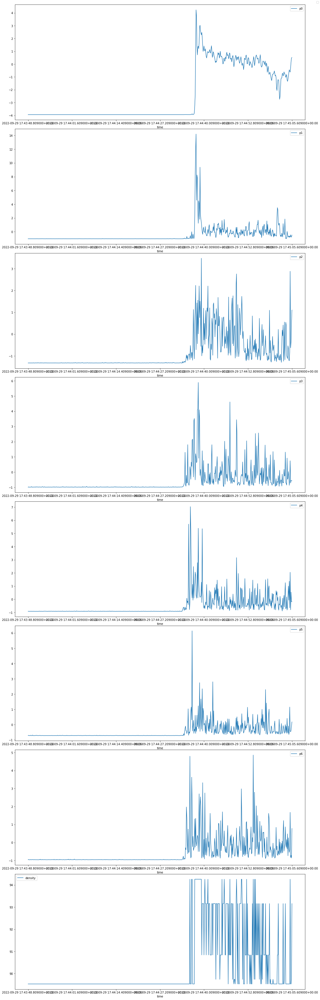

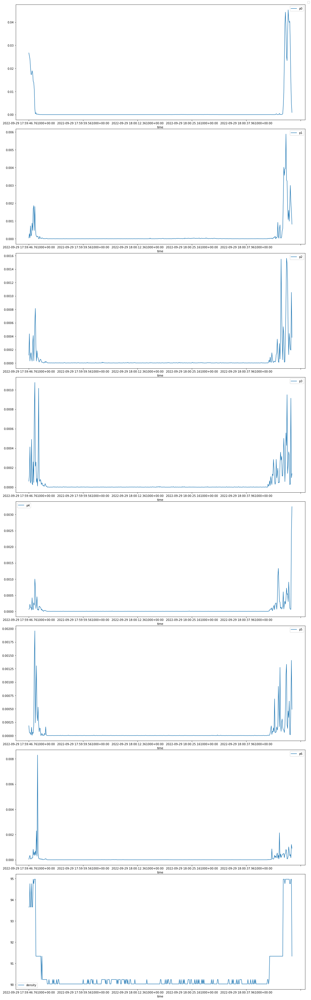

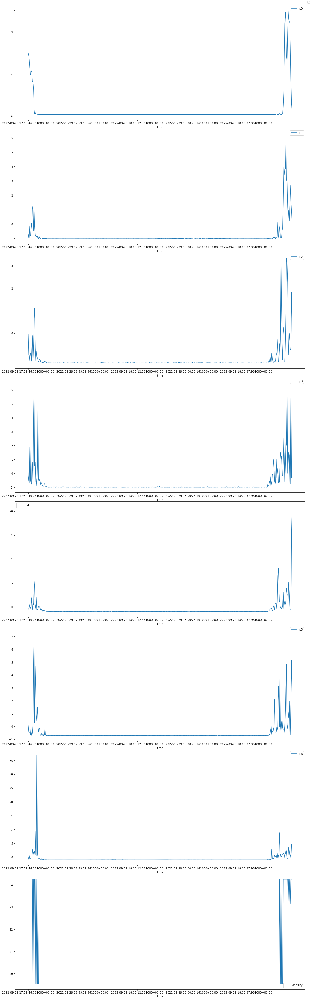

In [54]:
def image_power_over_cores_each_pass(raw_power,std_power,cores_data,folder_loc):
    for pass1_core1 in cores_data.values:
        raw_power_in_it=raw_power[(raw_power["time"]>=pass1_core1[2]) &
                                  (raw_power["time"]<=pass1_core1[3])]
        print(raw_power_in_it.head())
        std_power_in_it=std_power[(std_power["time"]>=pass1_core1[2]) &
                                 (std_power["time"]<=pass1_core1[3])]
        print("############  NEXT  ##############")
        create_plots(raw_power_in_it, 7, folder_loc/pass1_core1[0] , pass1_core1[0]+"_raw__passId="+str(pass1_core1[1])+".png", norm=True)
        create_plots(std_power_in_it, 7, folder_loc/pass1_core1[0] , pass1_core1[0]+"_std__passId="+str(pass1_core1[1])+".png", norm=True)


image_power_over_cores_each_pass(raw_power,
                                 std_power,
                                 cores_data,
                                 folder_loc=home_folder_to_get_and_save/"image_data_in_cores")

In [ ]:
# folder_loc="/home/shankar/GRA/R@/rica/projects/Core_location_predict/get_data_given_cores/models/day_1_62.5/predict_all_database/predict_oct_13/image_data_in_cores"

# for pass1_core1 in cores_data.values:
#     raw_power_in_it=raw_power[(raw_power["time"]>=pass1_core1[2]) &
#                               (raw_power["time"]<=pass1_core1[3])]
#     print(raw_power_in_it.head())
#     std_power_in_it=std_power[(std_power["time"]>=pass1_core1[2]) &
#                              (std_power["time"]<=pass1_core1[3])]
#     print(std_power_in_it.head())
#     print("############  NEXT  ##############")
#     create_plots(raw_power_in_it, 5, folder_loc+"/"+pass1_core1[0] , pass1_core1[0]+"_raw__passId="+str(pass1_core1[1])+".png", norm=True)
#     create_plots(std_power_in_it, 5, folder_loc+"/"+pass1_core1[0] , pass1_core1[0]+"_std__passId="+str(pass1_core1[1])+".png", norm=True)
       

# Plots of each pass and the core for power

In [98]:
gb=cores_data.groupby(["passID"])
groups = dict(list(gb))
for i in groups[0].values:
    print(type(i[2]))

<class 'str'>
<class 'str'>
<class 'str'>


/home/shankar/anaconda3/envs/rica/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


<class 'pandas._libs.tslibs.timestamps.Timestamp'>
CORE_P ['Lathrop, R3, NDG 95' 0.0 '2022-09-29 15:34:37.643000+00:00'
 '2022-09-29 18:04:11.809000+00:00']
CORE_P ['Lathrop, R2, NDG 95' 0.0 '2022-09-29 15:37:09.707000+00:00'
 '2022-09-29 15:37:11.499000+00:00']
CORE_P ['Lathrop, R1, NDG 95' 0.0 '2022-09-29 15:33:26.731000+00:00'
 '2022-09-29 15:33:28.523000+00:00']
<class 'pandas._libs.tslibs.timestamps.Timestamp'>
CORE_P ['Lathrop, R3, NDG 95' 0.0 '2022-09-29 15:34:37.643000+00:00'
 '2022-09-29 18:04:11.809000+00:00']
CORE_P ['Lathrop, R2, NDG 95' 0.0 '2022-09-29 15:37:09.707000+00:00'
 '2022-09-29 15:37:11.499000+00:00']
CORE_P ['Lathrop, R1, NDG 95' 0.0 '2022-09-29 15:33:26.731000+00:00'
 '2022-09-29 15:33:28.523000+00:00']
<class 'pandas._libs.tslibs.timestamps.Timestamp'>
CORE_P ['Lathrop, R3, NDG 95' 0.0 '2022-09-29 15:34:37.643000+00:00'
 '2022-09-29 18:04:11.809000+00:00']
CORE_P ['Lathrop, R2, NDG 95' 0.0 '2022-09-29 15:37:09.707000+00:00'
 '2022-09-29 15:37:11.499000+00:00']

TypeError: plot_it() got an unexpected keyword argument 'Raw'

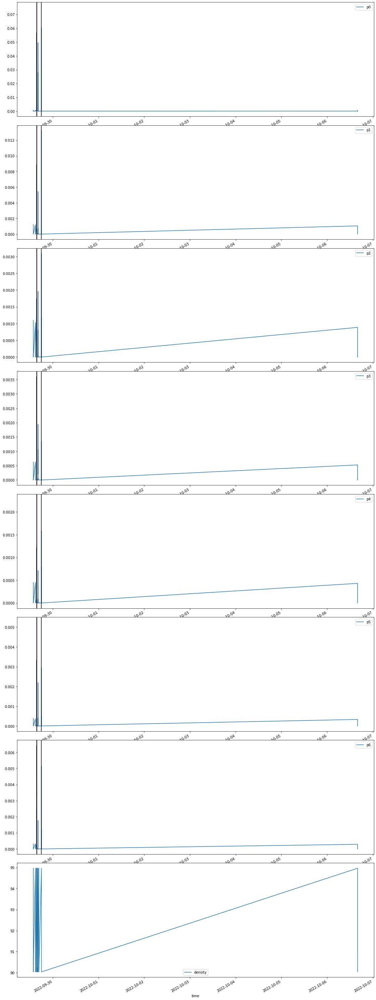

In [101]:
def whole_pass_showing_core(core_data,raw_power,std_power,home_folder,folder_name):
    gb=cores_data.groupby(["passID"])
    groups = dict(list(gb))
    create_folders(groups.keys(),
                   home_folder/folder_name)
    
    for i in groups:
        raw_power_to_print=raw_power[raw_power["passID"]==i]
        std_power_to_print=std_power[std_power["passID"]==i]
        
        def plot_it(power_data,raw=True):
            power_data["time"]=pd.to_datetime(power_data["time"])
            no_of_subplots = 7
            fig, axes = plt.subplots(no_of_subplots + 1, 1, figsize=(15, 49))
            fig.tight_layout()
            for position in range(no_of_subplots):
                print(type(power_data["time"].iloc[0]))
                power_data.plot(x="time", y="p" + str(position), ax=axes[position])
                for core_p in groups[i].values:
                    print("CORE_P",core_p)
                    axes[position].axvline(x=core_p[2],color="red")
                    axes[position].axvline(x=core_p[3],color="black")
            power_data.plot(x="time", y="density", ax=axes[no_of_subplots])
            to_save_location=home_folder/folder_name/str(i)
            if raw:
                raw_or="RAW"
            else:
                raw_on="STD"
            image_name=f"power_plot_of_pass_{i}_{raw_or}.png"
            fig.savefig(to_save_location / image_name)
        
        plot_it(raw_power_to_print)
        plot_it(std_power_to_print,Raw=False)
        print("Next")
        
    
whole_pass_showing_core(cores_data,
                        raw_power,
                        std_power,
                        home_folder=home_folder_to_get_and_save,
                        folder_name="image_data_pwer_passID_over_core")   

# Next_Analysis


In [12]:
def read_yml(path_to_calib_yml_file):
    with open(path_to_calib_yml_file, "r") as fid:
        d = yaml.safe_load(fid)
    return d

In [13]:
calib=read_yml("/home/shankar/GRA/R@/rica/projects/Core_location_predict/get_data_given_cores/models/day_1_62.5/predict_all_database/calib.yml")
calib

{'fundFreq': 62.5,
 'mean': [0.03597122232430724,
  0.0008274363992262972,
  0.0004437434451541327,
  0.0001417320387837821,
  0.00013665495239215112,
  0.00017233445357784112,
  0.0002098932372664588],
 'std': [0.009135340918451237,
  0.0008090763460758327,
  0.0003353746554938399,
  0.00014314340672892054,
  0.00014826194239559308,
  0.00024041653135198335,
  0.00021892735867521564],
 'minDensity': 89,
 'maxDensity': 95}

In [14]:
x=100860
raw_power["p0"].iloc[x],(raw_power["p0"].iloc[x]-calib["mean"][0])/calib["std"][0],std_power["p0"].iloc[x]

(0.0452574575593902, 1.0165176448234083, 1.016517644823412)

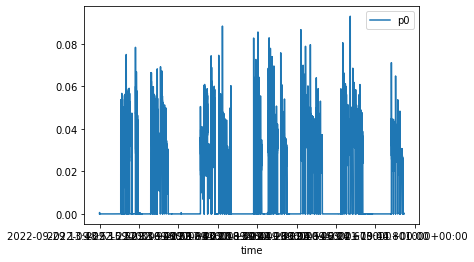

In [15]:
raw_power.plot(x="time",y="p0")

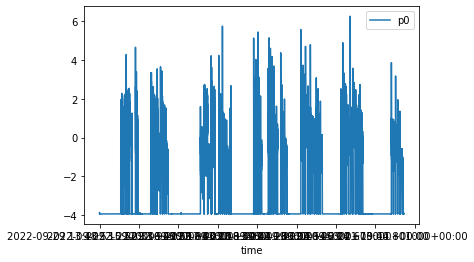

In [16]:
std_power.plot(x="time",y="p0")